In [3]:
%pylab inline
from itertools import combinations


matplotlib.rc('xtick', labelsize=15) 
matplotlib.rc('ytick', labelsize=15) 


matplotlib.rcParams['ps.useafm'] = True
matplotlib.rcParams['pdf.use14corefonts'] = True
matplotlib.rcParams['text.usetex'] = True


import pylab
pylab.rcParams['figure.figsize'] = (6.0, 6.0)

Populating the interactive namespace from numpy and matplotlib


# Active behaviors for Perimeter Surveillance

Grouping for $G^T$.
Lets create a r-robust network.

There are $n=(r+1)m$, $m=\mathbb{N}$ robots, where at every time interval, there are $m$ groups with $r$ robots.


In [4]:
r = 3  # number of elements in the groups
m = 4  # number of groups
n = (r+1)*m  # number of robots
V = range(n)  # vertices

# equally distributed
Θ = linspace(0, 2*pi, n, endpoint=False)
rad = 1.  # Radio of the 
R = .8  # communication radio

## 
random.seed(0)
radv = rad + rad*np.random.rand(n)*.6


fx = lambda rad,Θ: rad * np.cos(Θ)
fy = lambda rad,Θ: rad * np.sin(Θ)
x,y = fx(radv,Θ), fy(radv,Θ)


def adjecency_matrix(x,y):
    A = np.zeros((n,n))
    
    for i in range(n):
        for j in range(n):
            if i==j:
                continue
            if hypot(y[j]-y[i], x[j]-x[i])<=R:
                A[i][j] = 1
    return A
                
            
## Communication radius
def draw_network(V,x,y, rad, Vm=[], Vmal=[], MalX=[] , crad=.4, ax=None):
    
    if ax is None:
        fig, ax = plt.subplots()
    ax.grid(alpha=.2)
    # Theta linespace 
    th = linspace(0,2*math.pi, 100)
    
    # Plot communication radious and label
    for (i, xi, yi, ri) in zip(V, x,y, rad):
        # Communication radio
        circle1 = plt.Circle((xi, yi), crad, color='y', alpha=0.5)
        ax.text(xi+.1, yi+.10, '$'+str(i)+'$', fontsize=15)
        
        # Value for radious
        ax.plot(ri*cos(th), ri*sin(th), linewidth=.15, alpha=0.2)  # linewidth=1.15 for movie
    
    # plot links
    A = adjecency_matrix(x,y)
    for i,j in combinations(V, 2):
        if A[i][j]:
            ax.plot([x[i], x[j]], [y[i], y[j]], 'b--', linewidth=2)
        
    # plot node
    ax.plot(x,y, 'go', markersize=10)
#     ax.plot((-1.5,1.5), (-1.5,1.5), '.')
    # Main nodes
    ax.plot(x[Vm],y[Vm], 'yo', markersize=10)

    # Malicious
    ax.plot(x[Vmal],y[Vmal], 'ro', markersize=10)
    
    for rx in MalX:
        ax.plot(rx*cos(th), rx*sin(th), 'r-', linewidth=.7, alpha=0.8) # linewidth=1.7 for movie
    


draw_network(V,x,y, radv, crad=R, Vmal=[0], MalX=[1.9])

savefig('network1.pdf', bbox_inches="tight")

SyntaxError: invalid syntax (<ipython-input-4-d030dbf13985>, line 7)

[0, 4, 8, 12]


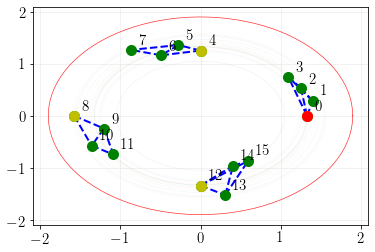

In [4]:
def draw_interval(I, ax=None):
    # Main nodes
    Vm = [((r+1)*k + I) for k in range(m)]
    print(Vm)
    # Followers
    Vf = [(i+k)%n for k in range(1,r+1) for i in Vm]

    # new theta
    ΘI = copy(Θ)

    # theta main
    ΘI[Vm] = Θ[Vm]
    # Theta followers
    ΘI[Vf] = [Θ[i]+.2*k for k in range(1,r+1) for i in Vm]

    x,y = fx(radv,ΘI), fy(radv, ΘI)

    draw_network(V,x,y, radv, Vm, crad=.4, Vmal=[0], MalX=[1.9], ax=ax)

# Interval
draw_interval(I=0)

savefig('network2.pdf', bbox_inches="tight")

## Simulaton

In [20]:
def SW_MSR(i, t, T, Alog, xlog, F=1):
    # Neighbors in the time interval
    A = Alog[-T:]
    Tp = len(A) # Time interval T when T<t
    own_x = xlog[-1][i]
    
    time_neighbor = {}  # Recent time
    # Recent values
    for τ in range(Tp):
        for j in V:
            if A[-Tp+τ][i][j]:
                time_neighbor[j]=τ
    
    tuples = [xlog[-Tp+τ][j] for j,τ in time_neighbor.items()]
    sorted_tuples = sorted(tuples)
    # Larger values
    largers = [tup for tup in sorted_tuples if tup>=own_x]
    # Smaller values
    smallers = [tup for tup in sorted_tuples if tup<=own_x]
    
    # Remove F largers and F smallers, and the own value
    remaining = smallers[F:]+largers[:-F] + [own_x]
    
    # Return the mean of the remaining values and the own value
    return mean(remaining)
    
#SW_MSR(0, 0, int((r+1) * Is), Alog, xlog)

In [16]:
malicious_f = lambda t: 1.3+.29*math.sin(10*t/.8+pi/2)

Is = 30.
T = int((r+1) * Is)
t_max = 400
Ω = .05

def run_simulation(malicious=False, swmsr=False):
    rho = np.copy(radv)  # Radius for consensus

    Θs = copy(Θ)
    
    kp = 0.08
    krho = .05
    
    Sr = pi/8

    
    Θlog = []
    Vllog = []
    Alog = []
    
    rho_0 = copy(rho)
    rho_0[0] = 1.57
    xlog = [rho_0]
    

    for t in range(t_max):
        I = int(floor(t/Is)) % (r+1)  # Interval number
        x,y = fx(rho,Θs), fy(rho,Θs)

        ## SW-MSR
        for i in V:
            consensus_val = (rho[i] + rho[(i+1)%n] + rho[i-1])/3.
            
            if swmsr:                
                consensus_val = SW_MSR(i, t, T, Alog, xlog)
            
            rho[i] +=  krho * (consensus_val - rho[i])
        
        if malicious:
            rho[0] = malicious_f(t)

        # Leaders
        Vl = [((r+1)*k + I) for k in range(m)]
        # For each leader
        for i in Vl:
            # For each follower
            for k in range(1,r+1):            
                j = (i + k) % n

                dij = (j-i)% n * Sr/r
                e = Θs[i] - Θs[j]  + dij           
                e = arctan2(sin(e), cos(e))

                Θs[j] += kp*(e)
        Θs += Ω

        Alog.append(adjecency_matrix(x,y))
        Θlog.append(copy(Θs))
        Vllog.append(copy(Vl))
        xlog.append(copy(rho))

    Vllog = np.array(Vllog)    
    Θlog = np.array(Θlog)
#     return xlog


    plt.xlabel('$t $',fontsize=22)
    plt.ylabel('$\\rho$',fontsize=22)
    
    for i in V:
        if i==0 and malicious:
            continue
        plot([xi[i] for xi in xlog])
        
    
    if malicious:
        plot([xi[0] for xi in xlog], '-r', linewidth=2.)    
    return  Θlog, Vllog, Alog, xlog 

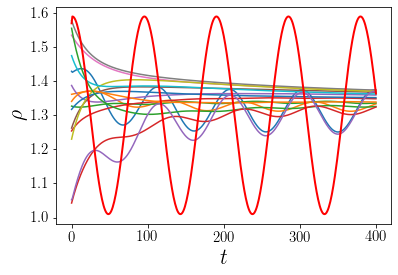

In [17]:
run_simulation(malicious=True, swmsr=False)
plt.savefig('rho_mal.pdf')

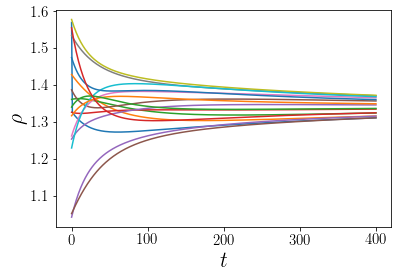

In [18]:
run_simulation(malicious=False, swmsr=False)
plt.savefig('rho_normal.pdf')


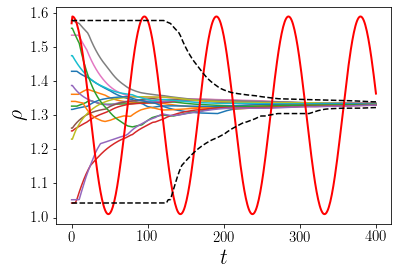

In [19]:
Θlog, Vllog, Alog, xlog  = run_simulation(malicious=True, swmsr=True)

max1, min1 = [], []
for t in range(len(xlog)):
    t1 = t-T if t-T>0 else 0
    cop_vals = [valst[1:] for valst in xlog[t1:t+1]]
    
    max1.append(np.max(cop_vals))
    min1.append(np.min(cop_vals))
    
plt.plot(max1, 'k--')
plt.plot(min1, 'k--')
    
plt.savefig('rho_swmsr.pdf')

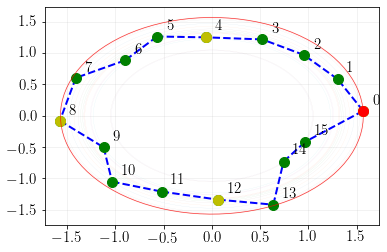

In [10]:
def draw_log(t, ax=None):
    A = Alog[t]
    # Locations from log
    Θs = Θlog[t]
    Vl = Vllog[t]
    rho_t = xlog[t]
    
    
    x,y = fx(rho_t,Θs), fy(rho_t,Θs)
    
    draw_network(V,x,y, rho_t,Vl, crad=R, Vmal=[0], MalX=[rho_t[0]], ax=ax)
    
ax = plt.axes()
draw_log(0,ax)
    
savefig('network1.pdf', bbox_inches="tight")

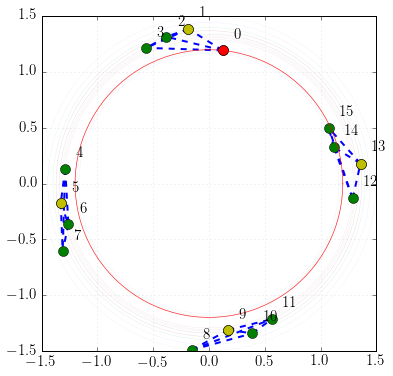

In [10]:
ax = plt.axes()
draw_log(30,ax)

savefig('network2.pdf', bbox_inches="tight")

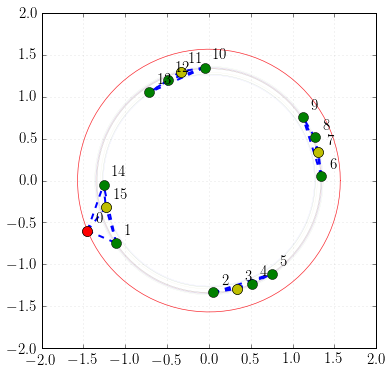

In [11]:
ax = plt.axes()
draw_log(90,ax)
savefig('network3.pdf', bbox_inches="tight")


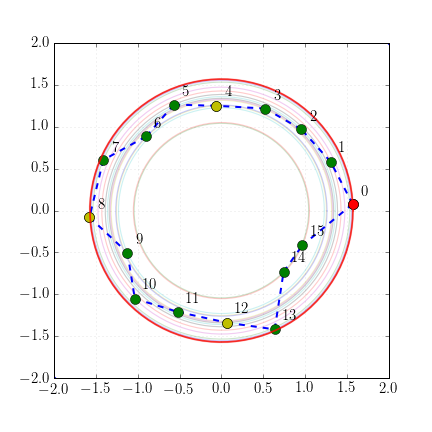
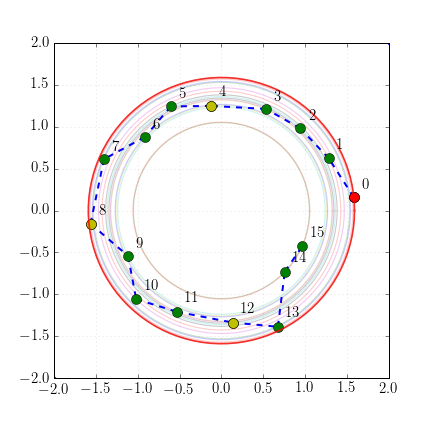
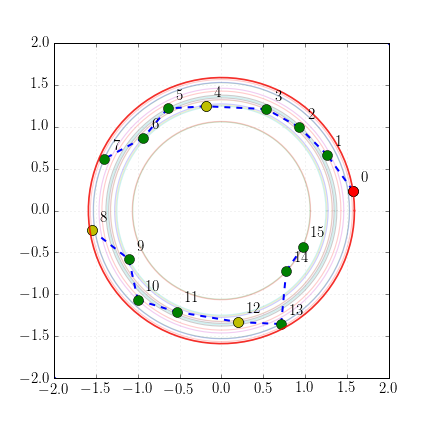
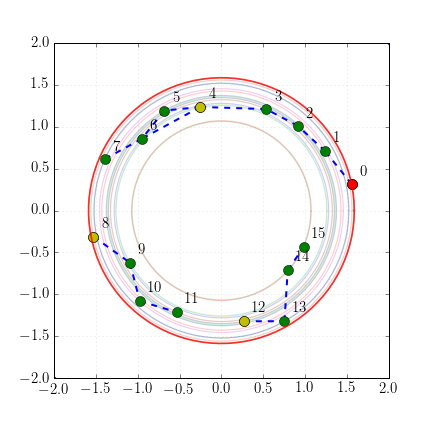
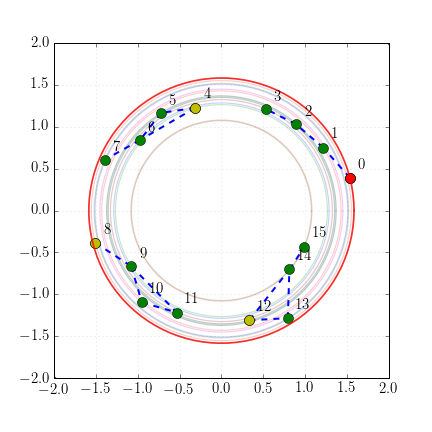
...
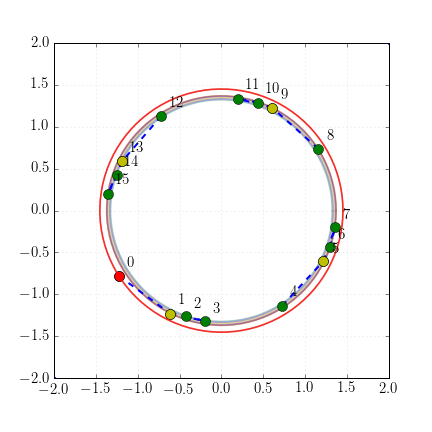
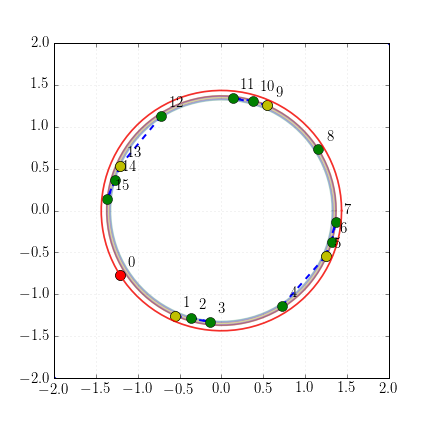
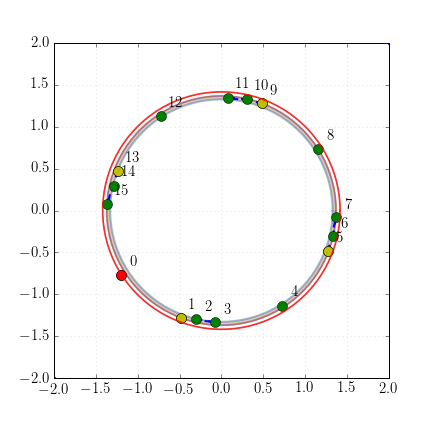
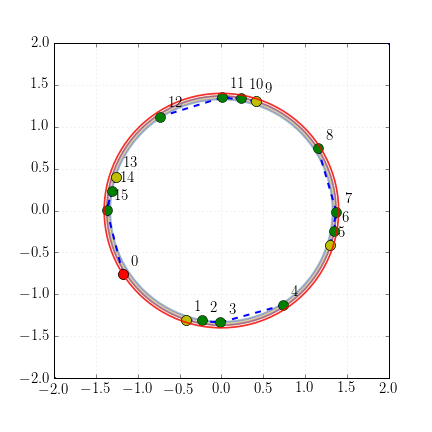
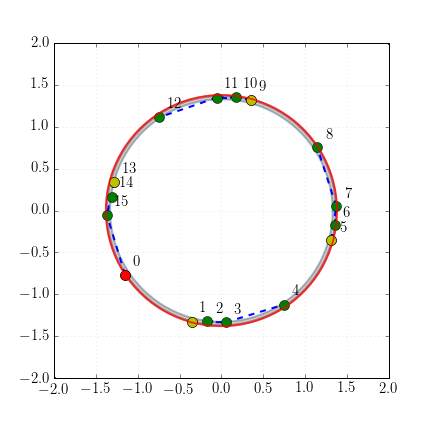

In [18]:
from JSAnimation import IPython_display
from matplotlib import animation

fig = plt.figure()
ax = plt.axes()

xsize, ysize = (-2., 2.),(-2., 2.)

Θs = Θlog[0]
x,y = fx(rad,Θs), fy(rad,Θs)

xm=1; ym=0

def animate(t):  
    global xm, ym
    
    ax.clear()
    pu = ax.plot(xsize, ysize, '.') 
    
    
    draw_log(t, ax)
    
    return pu
    
anim = animation.FuncAnimation(fig, animate, frames=t_max, interval=100, blit=True)

anim

In [22]:
anim.save('encirclement_novel.mp4', dpi=350)


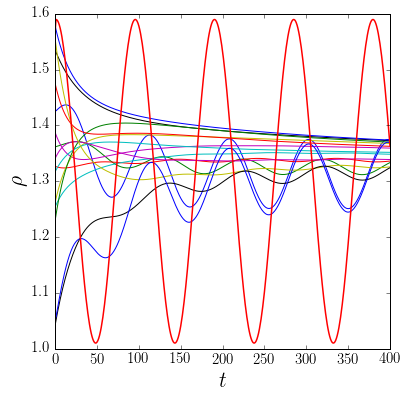

In [14]:
Θlog, Vllog, Alog, xlog  = run_simulation(malicious=True, swmsr=False)

max1, min1 = [], []
for t in range(len(xlog)):
    t1 = t-T if t-T>0 else 0
    cop_vals = [valst[1:] for valst in xlog[t1:t+1]]
    
    max1.append(np.max(cop_vals))
    min1.append(np.min(cop_vals))